# Advanced Data Analytics for Management Support - Assignment Submission

## Contents
1. [Introduction](#introduction)
2. [Data Loading and Preliminary Cleaning](#data_loading+cleaning)
3. [Non-Text Features](#nontext)
    1. [Data Exploration](#dataexplor_nontext)
    2. [Feature Engineering](#feat_eng_nontext) 
    3. [Handling Missing Values](#missing_values_nontext)
3. [Text Features](#nontext)
    1. [Data Exploration](#dataexplor_nontext)
    2. [Feature Engineering](#feat_eng_nontext) 
    3. [Handling Missing Values](#missing_values_nontext)
6. [Results](#results)
7. [Discussion](#discussion)
8. [Conclusion](#conclusion)
9. [Bibliography](#bibliography)

## 1. Introduction <a name="introduction"></a>

In [344]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

import re

from pandas_profiling import ProfileReport
import missingno as msno

import geopy.distance

import datetime

import warnings
warnings.filterwarnings("ignore")

## 2. Data Loading and Preliminary Cleaning <a name="data_loading+cleaning"></a>

In [742]:
train = pd.read_csv('data/train.csv')
test = pd.read_csv('data/test.csv')

In [743]:
print('Columns in train and test set differ in element:', np.setdiff1d(train.columns, test.columns)[0])

Columns in train and test set differ in element: price


In [609]:
# generate EDA report
profile = ProfileReport(train, explorative=True)

# save results to HTML
profile.to_file("eda_report.html")

Summarize dataset:   0%|          | 0/56 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [514]:
profile.to_notebook_iframe()

Convert features to correct format.
* several features take on only integer values, we will convert these to the appropriate data type.

In [744]:
int_cols = ['host_id', 
            'host_total_listings_count',
            'review_scores_rating', 
            'review_scores_accuracy', 
            'review_scores_cleanliness',
            'review_scores_checkin',
            'review_scores_communication',
            'review_scores_location',
            'review_scores_value' 
           ]

train[int_cols] = train[int_cols].apply(pd.to_numeric, errors='coerce')
test[int_cols] = test[int_cols].apply(pd.to_numeric, errors='coerce')

* convert host_response_rate to a numeric feature

In [745]:
train.host_response_rate = train.host_response_rate.astype(str).apply(lambda x: float(x.strip('%')) / 100)
test.host_response_rate = test.host_response_rate.astype(str).apply(lambda x: float(x.strip('%')) / 100)

* initial look at missing values (maybe via heatmap)

### A little bit of initial feature engineering
* transform amenities into proper feature(s) --> not usable at the moment

In [746]:
# first step: remove curly braces and quotation marks which are used irregularly
train.amenities = train.amenities.apply(lambda x: x.replace('{', '').replace('}', '').replace('"', ''))
test.amenities = test.amenities.apply(lambda x: x.replace('{', '').replace('}', '').replace('"', ''))

In [747]:
# list most common amenities
train.amenities.apply(lambda x: x.split(',')).explode().value_counts()[0:60]

Wifi                                          53049
Heating                                       52332
Essentials                                    51668
Kitchen                                       50471
Smoke detector                                47733
Washer                                        47083
Hangers                                       44415
Iron                                          42213
Hair dryer                                    38954
Shampoo                                       37855
TV                                            37701
Laptop friendly workspace                     34881
Carbon monoxide detector                      32801
Hot water                                     31157
Dryer                                         24105
Refrigerator                                  23459
Dishes and silverware                         22075
Oven                                          20625
Bed linens                                    20169
Microwave   

* notice that for some amenities the English translations are missing: not a huge problem as we will focus on a few amenities only

In [748]:
# select from top60 only those that may have an effect on price (and restrict to 10):
# Wifi
# Kitchen
# Washer
# TV
# Elevator
# Breakfast
# Patio or balcony
# Garden or backyard
# Indoor fireplace
# Air conditioning

* create new dummy columns and set to 1 if included in a listing's amenities

In [749]:
top_amenities = ['wifi',
       'kitchen', 
       'washer', 
       'tv', 
       'elevator',
       'breakfast',
       'patio_or_balcony', 
       'garden_or_backyard', 
       'indoor_fireplace', 
       'air_conditioning']

train[top_amenities] = 0

In [750]:
train.amenities = train.amenities.apply(lambda x: x.split(','))

In [751]:
top_amenities_full_string = ['Wifi',
       'Kitchen', 
       'Washer', 
       'TV', 
       'Elevator',
       'Breakfast',
       'Patio or balcony', 
       'Garden or backyard', 
       'Indoor fireplace', 
       'Air conditioning']

for i in range(len(top_amenities)):
    train[top_amenities[i]] = [int(top_amenities_full_string[i] in a) for a in train.amenities]

* recreate for test set

In [752]:
test[top_amenities] = 0

test.amenities = test.amenities.apply(lambda x: x.split(','))

for i in range(len(top_amenities)):
    test[top_amenities[i]] = [int(top_amenities_full_string[i] in a) for a in test.amenities]

#### Use latitude and longitude to calculate distance (in km) from city center

* Center of London: Trafalgar Square, located at Latitude: 51.5085 Longitude: -0.1282 (https://www.findlatitudeandlongitude.com/l/Trafalgar+Square%2C+London%2C+United+Kingdom/4196266/) 

In [753]:
center_london = (51.5085, -0.1282)

train['distance_from_center'] = 0

train['distance_from_center'] = [geopy.distance.geodesic(coord, center_london).km for coord in zip(train.latitude, train.longitude)]

In [754]:
test['distance_from_center'] = 0

test['distance_from_center'] = [geopy.distance.geodesic(coord, center_london).km for coord in zip(test.latitude, test.longitude)]

In [755]:
# drop latitude and longitude
train.drop(['latitude', 'longitude'], axis=1, inplace=True)
test.drop(['latitude', 'longitude'], axis=1, inplace=True)

* turn host_since into feature host_how_long (days)

In [756]:
train.host_since.sort_values(ascending = False).head(1) # latest date is January 8, 2020

45251    2020-01-08
Name: host_since, dtype: object

In [757]:
# note: host_since has NaN values, need to deal with these before proceeding further
train.host_since.isna().sum(), test.host_since.isna().sum()

(111, 65)

In [758]:
# create dummy 
train['host_since_missing'] = train['host_since'].isnull()
test['host_since_missing'] = test['host_since'].isnull()

In [759]:
train['host_since'].fillna('2000-01-01', inplace=True)
test['host_since'].fillna('2000-01-01', inplace=True)

In [760]:
train.host_since.isna().sum(), test.host_since.isna().sum()

(0, 0)

In [761]:
train['days_as_host'] = 0

train['days_as_host'] = train.host_since.apply(lambda x: (date(2020,1,8) - datetime.datetime.strptime(x, "%Y-%m-%d").date()).days)

test['days_as_host'] = 0

test['days_as_host'] = test.host_since.apply(lambda x: (date(2020,1,8) - datetime.datetime.strptime(x, "%Y-%m-%d").date()).days)

In [762]:
# insert NA values again
train[train['host_since_missing'] == 1]['days_as_host'] = np.nan
test[test['host_since_missing'] == 1]['days_as_host'] = np.nan

* host_total_listings count has count of 0 for some listings
    --> find total number of listings for these hosts in the current dataframe, insert value

In [763]:
df_total_listings_train = pd.DataFrame({'host_total_listings_count': train[train['host_total_listings_count'] == 0].groupby('host_id').size()})

In [764]:
df_total_listings_train = df_total_listings_train.rename_axis('host_id').reset_index()

In [765]:
train.set_index('host_id', inplace=True)
train.update(df_total_listings_train.set_index('host_id'))
train = train.reset_index()

In [766]:
# check if it worked:
print('Number of observations in training set with count of total listings equal zero:',len(train[train['host_total_listings_count'] == 0]))

Number of observations in training set with count of total listings equal zero: 0


In [767]:
# do the same for test set
df_total_listings_test = pd.DataFrame({'host_total_listings_count': test[test['host_total_listings_count'] == 0].groupby('host_id').size()})

In [768]:
df_total_listings_test = df_total_listings_test.rename_axis('host_id').reset_index()

In [769]:
test.set_index('host_id', inplace=True)
test.update(df_total_listings_test.set_index('host_id'))
test = test.reset_index()

* are there any duplicate listings? (name, picture url)

In [770]:
train.name.value_counts()[0:10]

Double room                                          28
Centrally Located Tower Hill/Aldagte East Studios    17
Luxury 3 Bed Two Minutes from Shoreditch Station     16
Luxury 2 bedroom in Central London                   15
Single room                                          14
Brick Lane Shoreditch Sanctuary                      12
Luxury 2 Bed In Maida Vale, Near Paddington          12
Double bedroom                                       12
Greater London Apartment                             11
Home away from home                                  11
Name: name, dtype: int64

In [771]:
# examine 3rd one in detail
train[train['name'] == 'Luxury 3 Bed Two Minutes from Shoreditch Station'][['host_id', 'host_total_listings_count']]

# conclude that same names simply result from listings in same building, posted by professional hosts,
# rest is due to names being generic

,host_id,host_total_listings_count
2411,2331446,66.0
2959,207477735,41.0
2975,248034547,43.0
18707,207477735,41.0
20915,207477735,41.0
24149,207477735,41.0
30759,248034547,43.0
35869,207477735,41.0
36955,2331446,66.0
37067,2331446,66.0


In [772]:
# notice also duplicates in picture url
train.picture_url.value_counts()

train[train['picture_url'] == train.picture_url.value_counts().index[0]][0:5]

# same thing: listings are most likely in same large apartment building, thus do not pose an issue

,host_id,name,summary,space,description,experiences_offered,neighborhood_overview,transit,house_rules,picture_url,...,tv,elevator,breakfast,patio_or_balcony,garden_or_backyard,indoor_fireplace,air_conditioning,distance_from_center,host_since_missing,days_as_host
8298,48165024,"One Bedroom Flat, Sloane Avenue - CC",This one bed flat is located in Chelsea Cloist...,NaN,This one bed flat is located in Chelsea Cloist...,none,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/d029c664-c...,...,1,1,0,0,0,1,0,3.295693,False,1526
12004,48165024,Sloane Avenue located One Bedroom Apt - CC,This one bed flat is located in Chelsea Cloist...,NaN,This one bed flat is located in Chelsea Cloist...,none,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/d029c664-c...,...,1,1,0,0,0,1,0,3.224145,False,1526
19966,48165024,Superb One Bedroom Apartment - Chelsea - CC,This one bed flat is located in Chelsea Cloist...,"The apartment includes: Towels, bedding, soap ...",This one bed flat is located in Chelsea Cloist...,none,NaN,"- To check in, you must go to the reception at...",NaN,https://a0.muscache.com/im/pictures/d029c664-c...,...,1,1,0,0,0,1,0,3.237074,False,1526
21079,48165024,One Bedroom with Sofabed sleeping 3 - CC,This one bed flat is located in Chelsea Cloist...,NaN,This one bed flat is located in Chelsea Cloist...,none,NaN,NaN,NaN,https://a0.muscache.com/im/pictures/d029c664-c...,...,1,1,0,0,0,1,0,3.354297,False,1526
23618,48165024,Superb One Bedroom Apartment in Chelsea - CC,This one bed flat is located in Chelsea Cloist...,"The apartment includes: Towels, bedding, soap ...",This one bed flat is located in Chelsea Cloist...,none,NaN,Sloane Square Tube Station - 10 minute walk S...,NaN,https://a0.muscache.com/im/pictures/d029c664-c...,...,1,1,0,0,0,1,0,3.284244,False,1526


* lastly, remove redundant or uninformative features

In [773]:
# neighbourhood contains same information as neighbourhood_cleansed
train.drop('neighbourhood', axis = 1, inplace = True)
test.drop('neighbourhood', axis = 1, inplace = True)

In [774]:
# drop host_id? (either here or later if needed for some EDA stuff)

## 3. Non-Text Features <a name="nontext"></a>

### 3a. Data Exploration <a name="dataexplor_nontext"></a>

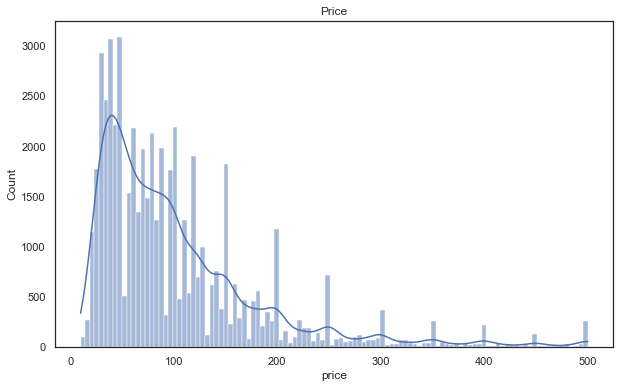

In [775]:
# distribution of target variable
plt.figure(figsize=(10,6))
sns.histplot(train.price, kde = True)
plt.title('Price');

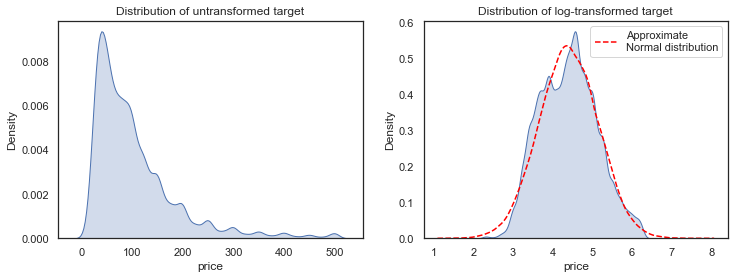

In [776]:
# to consider: log-transform target variable to achieve approximate normal distribution;
# may improve predictive performance in regression models down the line
plt.figure(figsize=(12,4))

plt.subplot(121)
sns.kdeplot(train.price, shade = True)
plt.title('Distribution of untransformed target')

plt.subplot(122)
sns.kdeplot(np.log(train.price), shade = True)
value = np.random.normal(loc=4.4,scale=0.75,size=100000)
sns.kdeplot(value, color='red', linestyle="--", label='Approximate\nNormal distribution')
plt.legend()
plt.title('Distribution of log-transformed target');

In [777]:
# look at correlation table, then examine a few relations with target variable in more detail before
# applying feature engineering

# rest: just do engineering / transformation straight away

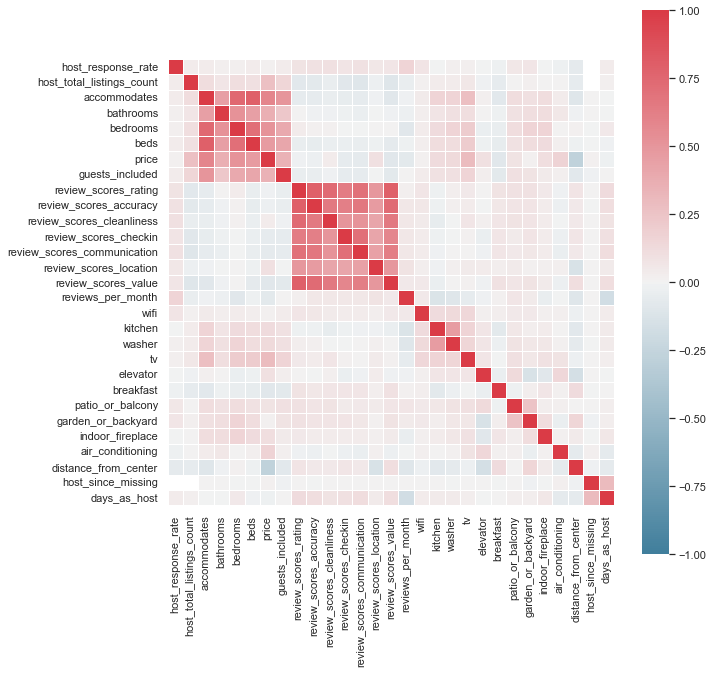

In [778]:
plt.figure(figsize=(10,10))

corr = train.drop('host_id', axis=1).corr()

cmap = sns.diverging_palette(230, 10, as_cmap=True)

sns.heatmap(corr, square=True, linewidths=.5, cmap=cmap, vmin=-1);

#### In-depth Analysis

* detailed look at relationship between selected features and target

    * neighbourhood_cleansed
    * experiences_offered
    * host_total_listings_count
    * zipcode?
    * property_type
    * room_type
    * accommodates
    * amenities: could plot average overall price vs avg(price) for each amenity (==1)
    * review_scores_rating
    * review_scores_location
    * distance_from_center

**Neighbourhood**

In [779]:
train.neighbourhood_cleansed.value_counts()

Westminster               6011
Tower Hamlets             5434
Hackney                   4135
Camden                    3935
Kensington and Chelsea    3696
Islington                 3284
Lambeth                   3223
Southwark                 3196
Wandsworth                2761
Hammersmith and Fulham    2656
Brent                     1645
Lewisham                  1490
Haringey                  1417
Newham                    1346
Ealing                    1168
Greenwich                 1129
Barnet                    1103
Waltham Forest             998
Merton                     858
Richmond upon Thames       782
Croydon                    741
Hounslow                   720
Redbridge                  479
Enfield                    472
Bromley                    457
Hillingdon                 413
Kingston upon Thames       362
City of London             297
Harrow                     291
Barking and Dagenham       251
Sutton                     196
Havering                   178
Bexley  

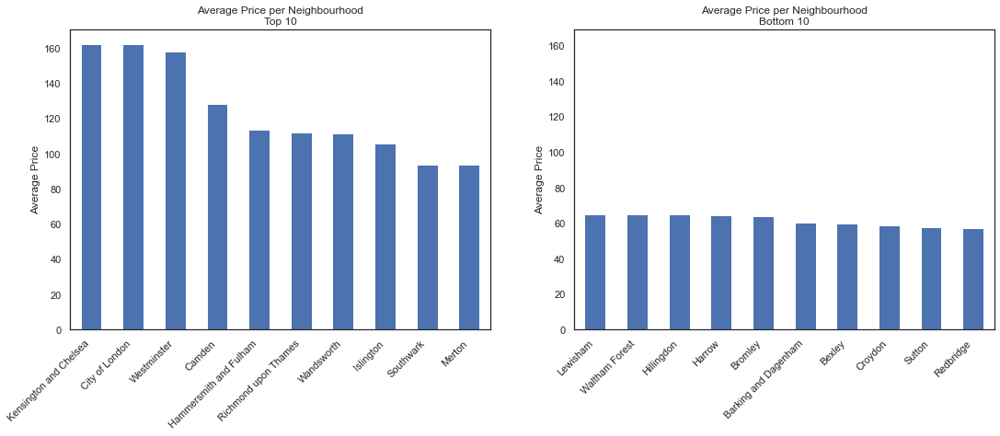

In [780]:
plt.figure(figsize=(18,6))

plt.subplot(121)

train.groupby("neighbourhood_cleansed")["price"].agg("mean").sort_values(ascending=False).head(10).plot.bar()
plt.xticks(rotation=45, ha='right')
plt.ylabel('Average Price')
plt.xlabel('')
plt.title('Average Price per Neighbourhood\nTop 10');

plt.subplot(122)

train.groupby("neighbourhood_cleansed")["price"].agg("mean").sort_values(ascending=False).tail(10).plot.bar()
plt.xticks(rotation=45, ha='right')
plt.ylabel('Average Price')
plt.xlabel('')
plt.ylim(0, 169)
plt.title('Average Price per Neighbourhood\nBottom 10');

**Offered Experiences**

In [781]:
train.experiences_offered.value_counts()

none        54222
business      364
family        300
social        266
romantic      132
Name: experiences_offered, dtype: int64

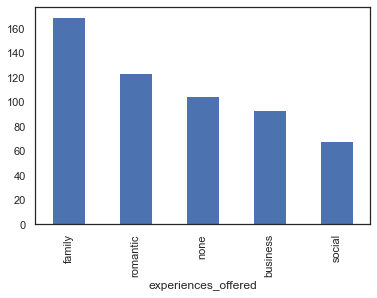

In [782]:
train.groupby("experiences_offered")["price"].agg("mean").sort_values(ascending=False).plot.bar();

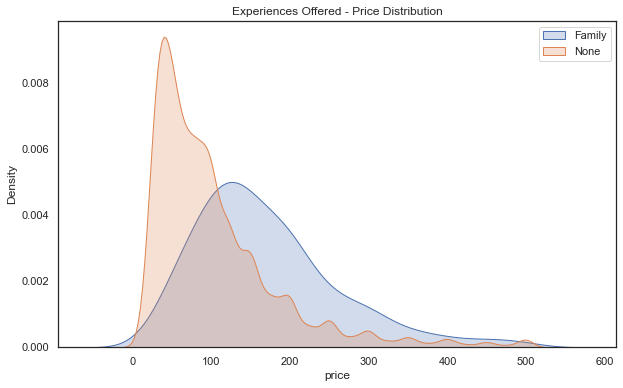

In [783]:
# exemplary deep dive: is higher average caused by outlier(s)?
x = train[train['experiences_offered'] == 'family']['price']
y = train[train['experiences_offered'] == 'none']['price']

fig, ax = plt.subplots(figsize=(10, 6))

sns.kdeplot(x, ax=ax, shade=True, label='Family')
sns.kdeplot(y, ax=ax, shade=True, label='None')
plt.legend()
plt.title('Experiences Offered - Price Distribution');

answer: no, price does appear to simply be higher on average for Airbnbs that offer 'family' experience

* low case count for all experiences, but might still be worth to include

**Host - Total Listings Count**

In [784]:
train['host_total_listings_count'].describe()

count    55173.000000
mean        20.810850
std        117.012921
min          1.000000
25%          1.000000
50%          2.000000
75%          5.000000
max       1321.000000
Name: host_total_listings_count, dtype: float64

In [785]:
# examine outlier
train[train['host_total_listings_count'] == 1321].head(5)

,host_id,name,summary,space,description,experiences_offered,neighborhood_overview,transit,house_rules,picture_url,...,tv,elevator,breakfast,patio_or_balcony,garden_or_backyard,indoor_fireplace,air_conditioning,distance_from_center,host_since_missing,days_as_host
179,33889201,Beautiful 1 bed flat in luxurious Kensington,This charming 1 bedroom flat is set over 2 flo...,LIVING ROOM With high ceilings and a charming...,This charming 1 bedroom flat is set over 2 flo...,none,"Blythe Road, Shepherd’s Bush Road and Hammersm...",Walk 10 minutes to Barons Court Station which ...,- The lead guest will be required to sign an O...,https://a0.muscache.com/im/pictures/38a39c86-c...,...,1,0,0,0,1,0,0,6.236075,False,1693
465,33889201,"Charming 2 BR home, 2 mins from the tube (Veeve)","A lovely Hampstead home, with country-style ch...","Situated on a small private cobbled path, this...","A lovely Hampstead home, with country-style ch...",none,"Situated in the lovely area of Hampstead, whic...",This property is conveniently located just a 2...,"- No pets, no parties or smoking, please. - Th...",https://a0.muscache.com/im/pictures/9f6a19bf-b...,...,1,0,0,0,1,1,0,7.694328,False,1693
791,33889201,3BR garden & terrace near London Fields (Veeve),"Complete with a pretty garden, as well as a ro...",At the front of the home is a welcoming front ...,"Complete with a pretty garden, as well as a ro...",none,This home is situated in Dalston- an arty and ...,This home is equidistant from several differen...,"- No pets, no parties or smoking, please. - T...",https://a0.muscache.com/im/pictures/60a8b6ec-c...,...,1,0,0,1,1,1,0,5.843378,False,1693
887,33889201,Up to 20% off! Littler Venice,This home is situated within a modern complex ...,HOME HIGHLIGHTS • Canal views • Convenient loc...,This home is situated within a modern complex ...,none,This property is located in London's 'Little V...,INTO TOWN You are 2 minutes away from Paddingt...,- The lead guest will be required to sign an O...,https://a0.muscache.com/im/pictures/2f1b5b5e-f...,...,1,0,0,0,0,0,0,3.651189,False,1693
922,33889201,Bright & Modern 3BR by the Cutty Sark (Veeve),Situated in pretty Greenwich in South-East Lon...,This home is situated on the 3rd floor of the ...,Situated in pretty Greenwich in South-East Lon...,none,Greenwich is home to the nearby National Marit...,Greenwich DLR station is a 1 minute walk from ...,"- No pets, no parties or smoking, please. - T...",https://a0.muscache.com/im/pictures/1ecd81f6-3...,...,1,1,0,1,0,0,0,8.548902,False,1693


* appears to be legitimate value

In [833]:
# turn into categories - is there a difference in average price?
# 1, 2-5, >5
bins = [0, 1, 5, 1500]
labels = ['1', '2-5', '5+']

df_temp = pd.DataFrame({'host_total_listings_count': pd.cut(train['host_total_listings_count'], bins, labels = labels, include_lowest = True), 'price': train.price})
df_temp.groupby('host_total_listings_count')['price'].agg('mean').sort_values(ascending=False)

host_total_listings_count
5+     146.627994
1       91.629002
2-5     91.311539
Name: price, dtype: float64

**Zipcode**

In [802]:
train.zipcode.value_counts().head(10).index

Index(['E1', 'NW1', 'N1', 'SE1', 'E2', 'W2', 'E14', 'SW11', 'SW6', 'E3'], dtype='object')

In [806]:
# for 5 most common zipcodes, look at average price
train[train['zipcode'].isin(train.zipcode.value_counts().head(10).index)].groupby('zipcode')['price', 'distance_from_center'].agg('mean')

,price,distance_from_center
zipcode,,
E1,83.719178,4.635372
E14,90.257143,7.725877
E2,73.389744,4.919678
E3,66.478632,7.644511
N1,104.545852,4.013420
NW1,109.199234,3.086525
SE1,111.889423,2.732891
SW11,106.732824,5.137784
SW6,133.610687,6.069497


SW6 is interesting given that it is quite far away from the center but the average price is really high

In [826]:
# how many listings with this zipcode?
print('The data contains', len(train[train['zipcode'] == 'SW6']),'listings with zipcode SW6.')

# what are most common neighbourhoods?
print('\n\nListings with zipcode SW6 are located in neighbourhoods:')
train[train['zipcode'] == 'SW6']['neighbourhood_cleansed'].value_counts()

# it appears that at least for this zipcode, the relevant information is contained in the neighbourhood_cleansed variable

The data contains 131 listings with zipcode SW6.


Listings with zipcode SW6 are located in neighbourhoods:


Hammersmith and Fulham    130
Wandsworth                  1
Name: neighbourhood_cleansed, dtype: int64

* infer/conclude that there exists an interaction between neighbourhood_cleansed and zipcode
* it appears that some zipcodes have very high average price, further refines neighbourhood variable

**Property Type**

In [870]:
temp = train[train['property_type'].isin(train['property_type'].value_counts().head(10).index)].groupby('property_type')['price'].agg('mean')

pd.DataFrame({'Nr. Obs.': train['property_type'].value_counts().head(10), 'Average Price': temp}).sort_values('Nr. Obs.', ascending=False)

,Nr. Obs.,Average Price
Apartment,36986,106.395258
House,11543,93.277917
Townhouse,1917,103.312467
Condominium,1717,120.271404
Serviced apartment,931,160.700322
Loft,496,100.614919
Bed and breakfast,372,79.688172
Guest suite,239,69.518828
Guesthouse,211,77.985782
Other,144,73.062500


In [ ]:
# examine distribution of price variable for certain property types

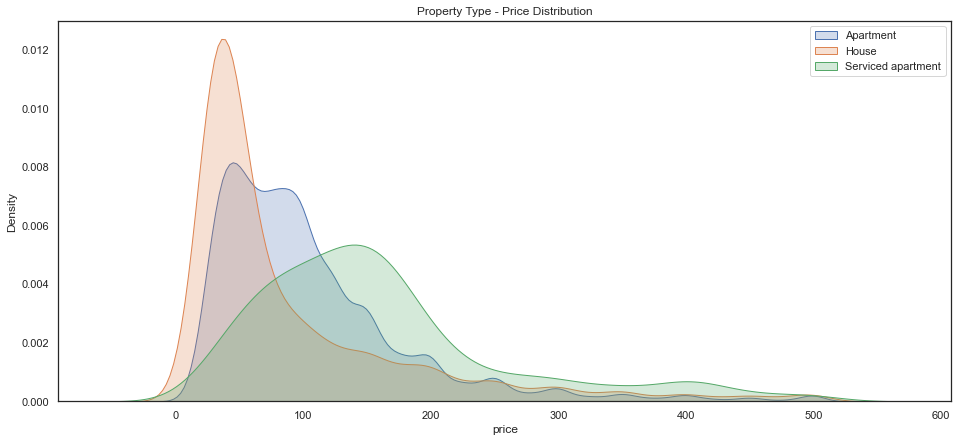

In [872]:
x = train[train['property_type'] == 'Apartment']['price']
y = train[train['property_type'] == 'House']['price']
z = train[train['property_type'] == 'Serviced apartment']['price']

fig, ax = plt.subplots(figsize=(16, 7))

sns.kdeplot(x, ax=ax, shade=True, label='Apartment')
sns.kdeplot(y, ax=ax, shade=True, label='House')
sns.kdeplot(z, ax=ax, shade=True, label='Serviced apartment')


plt.legend()
plt.title('Property Type - Price Distribution');

**Room Type**

In [875]:
train.groupby('room_type')['price'].agg('mean')

room_type
Entire home/apt    144.324712
Hotel room         144.441558
Private room        53.132300
Shared room         49.099057
Name: price, dtype: float64

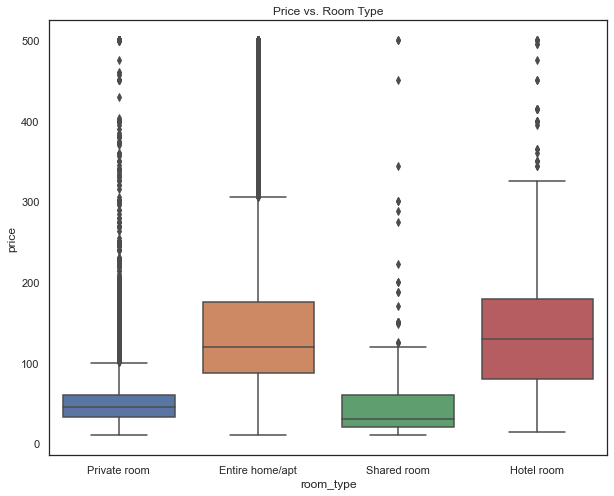

In [879]:
plt.figure(figsize=(10,8))

sns.boxplot(data=train, x='room_type', y='price')
plt.title('Price vs. Room Type');

**Accommodates**

**Amenities**

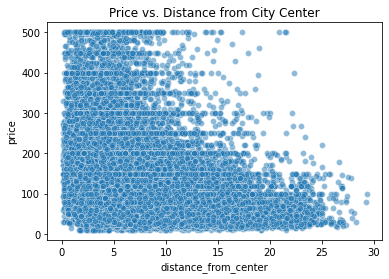

In [216]:
sns.scatterplot(train.distance_from_center, train.price, alpha = 0.5)
plt.title('Price vs. Distance from City Center');

### 3b. Feature Engineering <a name="feat_eng_nontext"></a> 

having explored the relationships among selected variables above, we are now ready to transform the data further and to refine or re-engineer some of the features

In [ ]:
# host_total_listings_count to category (1, 2-5, 5+)
train['host_total_listings_count'] = pd.cut(train['host_total_listings_count'], bins, labels = labels, include_lowest = True)

### 3c. Handling Missing Values <a name="missing_values_nontext"></a> 

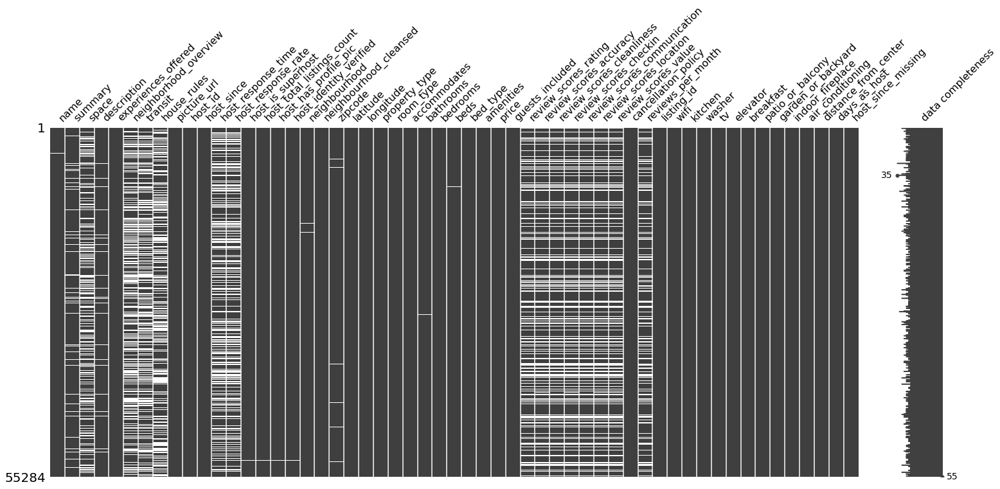

In [346]:
msno.matrix(train, labels=True);

* note: identical pattern for missing values for host_response_time & host_response_rate, as well as for all review_scores variables